# MNIST

Neste exercício, usaremos o conjunto de dados MNIST, que é um conjunto de 70.000 pequenas imagens de dígitos manuscritos por estudantes do ensino médio e funcionários do US Census Bureau. Cada imagem é rotulada com o dígito que representa. Esse conjunto foi estudado tanto que costuma ser chamado de “Olá Mundo” do Machine Learning: sempre que as pessoas criam um novo algoritmo de classificação, ficam curiosas para ver como ele será executado no MNIST. Sempre que alguém aprende o Machine Learning, mais cedo ou mais tarde ele enfrenta o MNIST.

https://en.wikipedia.org/wiki/MNIST_database

![https://upload.wikimedia.org/wikipedia/commons/2/27/MnistExamples.png](https://upload.wikimedia.org/wikipedia/commons/2/27/MnistExamples.png)
              Referência: https://upload.wikimedia.org/wikipedia/commons/2/27/MnistExamples.png

# Parte 0

The probability of correctly diagnosing a rare disease is 0.70. When diagnosed correctly, the probability of cure is 0.90. If not diagnosed correctly, the probability of cure is 0.40. If the patient with the disease is cured, what is the probability that he has been diagnosed correctly?

In [1]:
def diagnose(sensitivity, specificity, prevelance, verbose=True):
    p_rare_disease = prevelance
    p_no_cure = 1-prevelance
    p_pos_cure = sensitivity
    p_neg_cure = specificity
    p_pos_no_cure = 1-specificity
    num = p_pos_cure*p_rare_disease
    den = p_pos_cure*p_rare_disease + p_pos_no_cure * p_no_cure
    prob = num/den
    return prob
diagnose(sensitivity=0.9, specificity=0.6, prevelance=0.7)

0.84

# Parte 1

Crie um classificador Naive Bayes para o MNIST dataset

In [2]:
import numpy as np
import pandas as pd

from sklearn.datasets import fetch_openml
mnist = fetch_openml('mnist_784', version=1)
df_mnist = pd.DataFrame(data = mnist.data, columns = mnist.feature_names)
df_mnist["target"] = mnist.target.astype(float)
df_mnist.head()

,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,...,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784,target
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0


In [3]:
from sklearn.naive_bayes import BernoulliNB
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

NB_clf = BernoulliNB()

le = preprocessing.OrdinalEncoder()
ly = preprocessing.LabelEncoder()

X = le.fit_transform(df_mnist.iloc[:, :-1])
y = ly.fit_transform(df_mnist.iloc[:, -1])

In [4]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size = 0.2)

NB_clf.fit(X_train, y_train)

BernoulliNB(alpha=1.0, binarize=0.0, class_prior=None, fit_prior=True)

In [5]:
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import accuracy_score

In [6]:
predict = NB_clf.predict(X_test)
accuracy_score(y_test, predict)

0.8338571428571429

Text(0.5, 0.98, 'Confusion matrix')

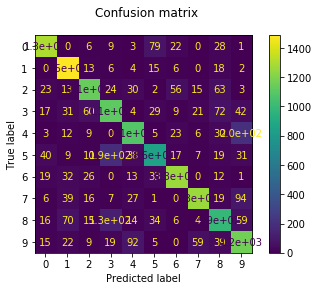

In [7]:
disp = plot_confusion_matrix(NB_clf, X_test, y_test)
disp.figure_.suptitle("Confusion matrix")

# Parte 2

Implemente o classificador para o MNIST utilizando apenas a biblioteca numpy e auxiliares. Não utilize o `scikit-learn`.

In [10]:
values = df_mnist["target"].value_counts()/len(df_mnist)
prob_targets = values.to_dict()
prob_targets

{1.0: 0.11252857142857142,
 7.0: 0.10418571428571428,
 3.0: 0.10201428571428571,
 2.0: 0.09985714285714285,
 9.0: 0.0994,
 0.0: 0.09861428571428571,
 6.0: 0.09822857142857143,
 8.0: 0.0975,
 4.0: 0.09748571428571429,
 5.0: 0.09018571428571429}

In [15]:
def get_proportions(given):
    dataset_filtered = df_mnist[df_mnist["target"] == given]
    size = len(dataset_filtered)
    values = dataset_filtered.iloc[:, :-1]/size
    features_given_proportions = values.to_dict()
    return features_given_proportions

In [16]:
get_proportions(0)

{'pixel1': {1: 0.0,
  21: 0.0,
  34: 0.0,
  37: 0.0,
  51: 0.0,
  56: 0.0,
  63: 0.0,
  68: 0.0,
  69: 0.0,
  75: 0.0,
  81: 0.0,
  88: 0.0,
  95: 0.0,
  108: 0.0,
  114: 0.0,
  118: 0.0,
  119: 0.0,
  121: 0.0,
  156: 0.0,
  169: 0.0,
  192: 0.0,
  206: 0.0,
  209: 0.0,
  210: 0.0,
  216: 0.0,
  229: 0.0,
  232: 0.0,
  234: 0.0,
  246: 0.0,
  249: 0.0,
  260: 0.0,
  283: 0.0,
  293: 0.0,
  296: 0.0,
  303: 0.0,
  320: 0.0,
  326: 0.0,
  359: 0.0,
  399: 0.0,
  427: 0.0,
  429: 0.0,
  435: 0.0,
  440: 0.0,
  451: 0.0,
  453: 0.0,
  458: 0.0,
  462: 0.0,
  464: 0.0,
  473: 0.0,
  489: 0.0,
  519: 0.0,
  524: 0.0,
  526: 0.0,
  527: 0.0,
  542: 0.0,
  577: 0.0,
  582: 0.0,
  596: 0.0,
  603: 0.0,
  612: 0.0,
  633: 0.0,
  639: 0.0,
  656: 0.0,
  662: 0.0,
  666: 0.0,
  667: 0.0,
  668: 0.0,
  669: 0.0,
  689: 0.0,
  702: 0.0,
  709: 0.0,
  712: 0.0,
  733: 0.0,
  743: 0.0,
  745: 0.0,
  776: 0.0,
  781: 0.0,
  787: 0.0,
  790: 0.0,
  818: 0.0,
  825: 0.0,
  849: 0.0,
  859: 0.0,
  860: 0